# GSE251950 Spatial Transcriptomics Analysis

This notebook processes and analyzes the GSE251950 dataset: **Spatial transcriptomics of gastric cancers using Visium 10X platform**.

## Dataset Information
- **Study**: Spatial dissection of tumour microenvironments in gastric cancers
- **Platform**: 10X Genomics Visium
- **Samples**: 9 primary gastric cancers (1 pair of primary-metastasis)
- **Publication**: Lee SH, Lee D, Choi J, et al. Gut 2025

## Analysis Overview
1. Data loading and quality control
2. Individual sample processing
3. Spatial visualization
4. Clustering analysis  
5. Integrated multi-sample analysis
6. Differential expression and pathway analysis

In [13]:
# Import Required Libraries
import os
import warnings
warnings.filterwarnings('ignore')

# Suppress scanpy warnings
import logging
logging.getLogger('scanpy').setLevel(logging.ERROR)

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path

# Scanpy for spatial transcriptomics analysis
import scanpy as sc

# Configure matplotlib and scanpy
plt.rcParams['figure.figsize'] = (8, 6)
plt.rcParams['figure.dpi'] = 100
sc.settings.verbosity = 1  # Reduce verbosity
sc.settings.set_figure_params(dpi=100, facecolor='white', figsize=(8, 6))

print("Libraries loaded successfully!")
print(f"Scanpy version: {sc.__version__}")
print(f"Pandas version: {pd.__version__}")
print(f"NumPy version: {np.__version__}")

Libraries loaded successfully!
Scanpy version: 1.11.4
Pandas version: 2.3.3
NumPy version: 2.3.3


## Setup and Data Discovery

First, let's explore the downloaded dataset structure and identify available samples.

In [14]:
# Setup directories and explore data structure
def setup_directories():
    """Create necessary directories for results"""
    directories = [
        "/Users/penguin/Documents/Spatial_Data/results",
        "/Users/penguin/Documents/Spatial_Data/results/figures", 
        "/Users/penguin/Documents/Spatial_Data/results/processed_data",
        "/Users/penguin/Documents/Spatial_Data/results/individual_samples",
        "/Users/penguin/Documents/Spatial_Data/results/combined_analysis"
    ]
    for directory in directories:
        Path(directory).mkdir(parents=True, exist_ok=True)
    return directories

def get_sample_directories(data_dir="GSE251950_data"):
    """Get list of sample directories"""
    sample_dirs = []
    if os.path.exists(data_dir):
        for item in os.listdir(data_dir):
            item_path = os.path.join(data_dir, item)
            if os.path.isdir(item_path) and not item.startswith('.') and not item.endswith('.tar'):
                # Check if it contains Visium data
                h5_file = None
                for file in os.listdir(item_path):
                    if file.endswith('_filtered_feature_bc_matrix.h5'):
                        h5_file = os.path.join(item_path, file)
                        break
                if h5_file and os.path.exists(h5_file):
                    sample_dirs.append(item_path)
    
    return sorted(sample_dirs)

# Setup
setup_directories()
# Neeeeeed hange directory here 
sample_dirs = get_sample_directories(data_dir="/Users/penguin/Documents/Spatial_Data")

print(f"Found {len(sample_dirs)} samples:")
for i, sample_dir in enumerate(sample_dirs, 1):
    sample_name = os.path.basename(sample_dir)
    print(f"  {i}. {sample_name}")
    
    # Check file contents
    files = os.listdir(sample_dir)
    h5_files = [f for f in files if f.endswith('.h5')]
    spatial_files = [f for f in files if 'spatial' in f or 'tissue' in f]
    
    print(f"     - H5 files: {len(h5_files)}")
    print(f"     - Spatial files: {len(spatial_files)}")
    print(f"     - Total files: {len(files)}")
    print()

Found 1 samples:
  1. 20_00331_LI_SING
     - H5 files: 2
     - Spatial files: 6
     - Total files: 14



## Load and Examine First Sample

Let's start by loading and examining the first sample to understand the data structure.

In [15]:
# Load the first sample to examine data structure
if sample_dirs:
    first_sample_path = sample_dirs[0]
    sample_name = os.path.basename(first_sample_path)
    
    print(f"Loading sample: {sample_name}")
    print(f"Path: {first_sample_path}")
    
    # List files in the sample directory to understand the structure
    files_in_sample = os.listdir(first_sample_path)
    print(f"Files in sample directory:")
    for file in files_in_sample:
        print(f"  - {file}")
    
    try:
        # Check if we need to rename files for scanpy compatibility
        h5_file = None
        positions_file = None
        scalefactors_file = None
        
        # Find the actual file names
        for file in files_in_sample:
            if file.endswith('_filtered_feature_bc_matrix.h5'):
                h5_file = file
            elif file.endswith('_tissue_positions_list.csv'):
                positions_file = file
            elif file.endswith('_scalefactors_json.json'):
                scalefactors_file = file
        
        print(f"\nFound key files:")
        print(f"  - H5 matrix: {h5_file}")
        print(f"  - Positions: {positions_file}")
        print(f"  - Scale factors: {scalefactors_file}")
        
        if h5_file:
            # Method 1: Create copies with expected names (more reliable than symlinks)
            import shutil
            
            # Create expected file names
            expected_h5 = os.path.join(first_sample_path, 'filtered_feature_bc_matrix.h5')
            expected_positions = os.path.join(first_sample_path, 'tissue_positions_list.csv')
            expected_scalefactors = os.path.join(first_sample_path, 'scalefactors_json.json')
            
            # Create spatial directory for scanpy
            spatial_dir = os.path.join(first_sample_path, 'spatial')
            os.makedirs(spatial_dir, exist_ok=True)
            
            # Create copies if they don't exist
            if not os.path.exists(expected_h5) and h5_file:
                source_h5 = os.path.join(first_sample_path, h5_file)
                if os.path.exists(source_h5):
                    shutil.copy2(source_h5, expected_h5)
                    print(f"  - Copied H5 file: {h5_file} -> filtered_feature_bc_matrix.h5")
                else:
                    print(f"  - Warning: Source H5 file not found: {source_h5}")
                
            if not os.path.exists(expected_positions) and positions_file:
                source_positions = os.path.join(first_sample_path, positions_file)
                if os.path.exists(source_positions):
                    shutil.copy2(source_positions, expected_positions)
                    print(f"  - Copied positions file: {positions_file} -> tissue_positions_list.csv")
                else:
                    print(f"  - Warning: Source positions file not found: {source_positions}")
                
            if not os.path.exists(expected_scalefactors) and scalefactors_file:
                source_scalefactors = os.path.join(first_sample_path, scalefactors_file)
                if os.path.exists(source_scalefactors):
                    shutil.copy2(source_scalefactors, expected_scalefactors)
                    print(f"  - Copied scalefactors file: {scalefactors_file} -> scalefactors_json.json")
                else:
                    print(f"  - Warning: Source scalefactors file not found: {source_scalefactors}")
            
            # Now try to load with scanpy
            # Copy spatial files to spatial directory
            spatial_positions = os.path.join(spatial_dir, 'tissue_positions_list.csv')
            spatial_scalefactors = os.path.join(spatial_dir, 'scalefactors_json.json')
            spatial_hires = os.path.join(spatial_dir, 'tissue_hires_image.png')
            spatial_lowres = os.path.join(spatial_dir, 'tissue_lowres_image.png')
            
            if not os.path.exists(spatial_positions) and positions_file:
                source_positions = os.path.join(first_sample_path, positions_file)
                if os.path.exists(source_positions):
                    shutil.copy2(source_positions, spatial_positions)
                    print(f"  - Copied positions to spatial directory")
            
            if not os.path.exists(spatial_scalefactors) and scalefactors_file:
                source_scalefactors = os.path.join(first_sample_path, scalefactors_file)
                if os.path.exists(source_scalefactors):
                    shutil.copy2(source_scalefactors, spatial_scalefactors)
                    print(f"  - Copied scalefactors to spatial directory")
            
            # Copy image files if they exist
            hires_image = None
            lowres_image = None
            for file in files_in_sample:
                if file.endswith('_tissue_hires_image.png'):
                    hires_image = file
                elif file.endswith('_tissue_lowres_image.png'):
                    lowres_image = file
            
            if not os.path.exists(spatial_hires) and hires_image:
                source_hires = os.path.join(first_sample_path, hires_image)
                if os.path.exists(source_hires):
                    shutil.copy2(source_hires, spatial_hires)
                    print(f"  - Copied hires image to spatial directory")
            
            if not os.path.exists(spatial_lowres) and lowres_image:
                source_lowres = os.path.join(first_sample_path, lowres_image)
                if os.path.exists(source_lowres):
                    shutil.copy2(source_lowres, spatial_lowres)
                    print(f"  - Copied lowres image to spatial directory")
            
            # Check if all required files exist
            required_files = ['filtered_feature_bc_matrix.h5', 'spatial/tissue_positions_list.csv', 'spatial/scalefactors_json.json']
            missing_files = [f for f in required_files if not os.path.exists(os.path.join(first_sample_path, f))]
            
            if missing_files:
                print(f"Missing required files: {missing_files}")
                raise FileNotFoundError(f"Required files missing: {missing_files}")
            
            adata = sc.read_visium(first_sample_path)
            adata.var_names_make_unique()  # Make variable names unique
            
            print(f"\n✓ Successfully loaded {sample_name}")
            print(f"Shape: {adata.shape} (spots x genes)")
            print(f"Spatial coordinates available: {'spatial' in adata.obsm}")
            
            # Display basic information
            print(f"\nBasic information:")
            print(f"- Number of spots: {adata.n_obs}")
            print(f"- Number of genes: {adata.n_vars}")
            print(f"- Observation keys: {list(adata.obs.keys())}")
            print(f"- Variable keys: {list(adata.var.keys())}")
            print(f"- Obsm keys (spatial data): {list(adata.obsm.keys())}")
            print(f"- Uns keys (metadata): {list(adata.uns.keys())}")
            
        else:
            print("No H5 matrix file found!")
            adata = None
        
    except Exception as e:
        print(f"Error loading sample: {e}")
        print(f"Error type: {type(e).__name__}")
        
        # Alternative method: Load components separately
        print("\nTrying alternative loading method...")
        try:
            # Load the H5 file directly
            if h5_file:
                h5_path = os.path.join(first_sample_path, h5_file)
                adata = sc.read_10x_h5(h5_path)
                
                # Make variable names unique
                adata.var_names_make_unique()
                
                # Load spatial coordinates if available
                if positions_file:
                    positions_path = os.path.join(first_sample_path, positions_file)
                    positions_df = pd.read_csv(positions_path, header=None, index_col=0)
                    positions_df.columns = ['in_tissue', 'array_row', 'array_col', 'pxl_row_in_fullres', 'pxl_col_in_fullres']
                    
                    # Filter to only include spots that are in the tissue and in our data
                    common_barcodes = adata.obs.index.intersection(positions_df.index)
                    adata = adata[common_barcodes, :]
                    positions_df = positions_df.loc[common_barcodes]
                    
                    # Add spatial coordinates
                    adata.obsm['spatial'] = positions_df[['pxl_col_in_fullres', 'pxl_row_in_fullres']].values.astype(float)
                    adata.obs['in_tissue'] = positions_df['in_tissue'].values
                    
                    # Add scale factors if available
                    if scalefactors_file:
                        import json
                        scalefactors_path = os.path.join(first_sample_path, scalefactors_file)
                        with open(scalefactors_path, 'r') as f:
                            scalefactors = json.load(f)
                        adata.uns['spatial'] = {sample_name: {'scalefactors': scalefactors}}
                    
                print(f"\n✓ Successfully loaded {sample_name} (alternative method)")
                print(f"Shape: {adata.shape} (spots x genes)")
                print(f"Spatial coordinates available: {'spatial' in adata.obsm}")
                
                if 'spatial' in adata.obsm:
                    print(f"Spatial coordinates shape: {adata.obsm['spatial'].shape}")
                    
            else:
                adata = None
                
        except Exception as e2:
            print(f"Alternative loading also failed: {e2}")
            
            # Try even more basic method - load matrix components separately
            print("\nTrying matrix component loading with proper file names...")
            try:
                # Find matrix files with actual names
                matrix_file = None
                barcodes_file = None
                features_file = None
                
                for file in files_in_sample:
                    if file.endswith('_matrix.mtx.gz'):
                        matrix_file = file
                    elif file.endswith('_barcodes.tsv.gz'):
                        barcodes_file = file
                    elif file.endswith('_features.tsv.gz'):
                        features_file = file
                
                if matrix_file and barcodes_file and features_file:
                    print(f"Found matrix components:")
                    print(f"  - Matrix: {matrix_file}")
                    print(f"  - Barcodes: {barcodes_file}")
                    print(f"  - Features: {features_file}")
                    
                    # Create copies with expected names for scanpy
                    import shutil
                    
                    expected_matrix = os.path.join(first_sample_path, 'matrix.mtx.gz')
                    expected_barcodes = os.path.join(first_sample_path, 'barcodes.tsv.gz')
                    expected_features = os.path.join(first_sample_path, 'features.tsv.gz')
                    
                    # Create copies
                    if not os.path.exists(expected_matrix):
                        shutil.copy2(os.path.join(first_sample_path, matrix_file), expected_matrix)
                    if not os.path.exists(expected_barcodes):
                        shutil.copy2(os.path.join(first_sample_path, barcodes_file), expected_barcodes)
                    if not os.path.exists(expected_features):
                        shutil.copy2(os.path.join(first_sample_path, features_file), expected_features)
                    
                    print("Created copies with expected names...")
                    
                    # Load using scanpy's 10x mtx reader
                    adata = sc.read_10x_mtx(
                        first_sample_path,
                        var_names='gene_symbols',
                        cache=True
                    )
                    adata = adata.T  # Transpose to have observations as rows
                    adata.var_names_make_unique()  # Make variable names unique
                    
                    print(f"✓ Successfully loaded {sample_name} (matrix method)")
                    print(f"Shape: {adata.shape} (spots x genes)")
                    
                    # Add spatial coordinates
                    if positions_file:
                        positions_path = os.path.join(first_sample_path, positions_file)
                        positions_df = pd.read_csv(positions_path, header=None, index_col=0)
                        positions_df.columns = ['in_tissue', 'array_row', 'array_col', 'pxl_row_in_fullres', 'pxl_col_in_fullres']
                        
                        # Filter to common barcodes
                        common_barcodes = adata.obs.index.intersection(positions_df.index)
                        adata = adata[common_barcodes, :]
                        positions_df = positions_df.loc[common_barcodes]
                        
                        # Add spatial coordinates
                        adata.obsm['spatial'] = positions_df[['pxl_col_in_fullres', 'pxl_row_in_fullres']].values.astype(float)
                        adata.obs['in_tissue'] = positions_df['in_tissue'].values
                        
                        print(f"Spatial coordinates added: {adata.obsm['spatial'].shape}")
                        
                        # Add scale factors if available
                        if scalefactors_file:
                            import json
                            scalefactors_path = os.path.join(first_sample_path, scalefactors_file)
                            with open(scalefactors_path, 'r') as f:
                                scalefactors = json.load(f)
                            adata.uns['spatial'] = {sample_name: {'scalefactors': scalefactors}}
                            print("Scale factors added")
                else:
                    print("Matrix components not found!")
                    adata = None
                    
            except Exception as e3:
                print(f"Matrix loading also failed: {e3}")
                adata = None
else:
    print("No sample directories found!")

Loading sample: 20_00331_LI_SING
Path: /Users/penguin/Documents/Spatial_Data/20_00331_LI_SING
Files in sample directory:
  - 20_00331_LI_SING_barcodes.tsv.gz
  - 20_00331_LI_SING_tissue_hires_image.png
  - tissue_positions_list.csv
  - 20_00331_LI_SING_matrix.mtx.gz
  - 20_00331_LI_SING_aligned_fiducials.jpg
  - 20_00331_LI_SING_features.tsv.gz
  - 20_00331_LI_SING_tissue_lowres_image.png
  - 20_00331_LI_SING_scalefactors_json.json
  - scalefactors_json.json
  - filtered_feature_bc_matrix.h5
  - 20_00331_LI_SING_detected_tissue_image.jpg
  - 20_00331_LI_SING_tissue_positions_list.csv
  - spatial
  - 20_00331_LI_SING_filtered_feature_bc_matrix.h5

Found key files:
  - H5 matrix: 20_00331_LI_SING_filtered_feature_bc_matrix.h5
  - Positions: 20_00331_LI_SING_tissue_positions_list.csv
  - Scale factors: 20_00331_LI_SING_scalefactors_json.json

✓ Successfully loaded 20_00331_LI_SING
Shape: (3834, 36601) (spots x genes)
Spatial coordinates available: True

Basic information:
- Number of spot

In [16]:
adata

AnnData object with n_obs × n_vars = 3834 × 36601
    obs: 'in_tissue', 'array_row', 'array_col'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

## Quality Control and Basic Statistics

Calculate quality control metrics and examine the distribution of key parameters.

In [17]:
# Quality control metrics
if adata is not None:
    # Make variable names unique
    adata.var_names_make_unique()
    
    # Add sample name
    adata.obs['sample'] = sample_name
    
    # Calculate QC metrics
    adata.var['mt'] = adata.var_names.str.startswith('MT-')  # Mitochondrial genes
    adata.var['ribo'] = adata.var_names.str.startswith(('RPS', 'RPL'))  # Ribosomal genes
    adata.var['hb'] = adata.var_names.str.contains('^HB[^(P)]')  # Hemoglobin genes
    
    sc.pp.calculate_qc_metrics(adata, qc_vars=['mt', 'ribo', 'hb'], 
                              percent_top=None, log1p=False, inplace=True)
    
    print(f"Quality control metrics calculated:")
    print(f"- Mitochondrial genes: {adata.var['mt'].sum()}")
    print(f"- Ribosomal genes: {adata.var['ribo'].sum()}")
    print(f"- Hemoglobin genes: {adata.var['hb'].sum()}")
    
    # Display QC statistics
    qc_metrics = ['total_counts', 'n_genes_by_counts', 'pct_counts_mt', 'pct_counts_ribo']
    print(f"\nQC Statistics:")
    print(adata.obs[qc_metrics].describe())
else:
    print("No data loaded to analyze.")

Quality control metrics calculated:
- Mitochondrial genes: 13
- Ribosomal genes: 103
- Hemoglobin genes: 12

QC Statistics:
       total_counts  n_genes_by_counts  pct_counts_mt  pct_counts_ribo
count   3834.000000        3834.000000    3834.000000      3834.000000
mean    2553.739990        1295.438185       0.554910         8.439149
std     3805.092773        1337.741763       0.563419         2.767621
min        2.000000           2.000000       0.000000         0.000000
25%      368.250000         310.250000       0.270246         6.714725
50%     1023.000000         786.000000       0.460443         8.317651
75%     3079.000000        1898.750000       0.685959         9.971194
max    35224.000000        7954.000000      10.000000        50.000000


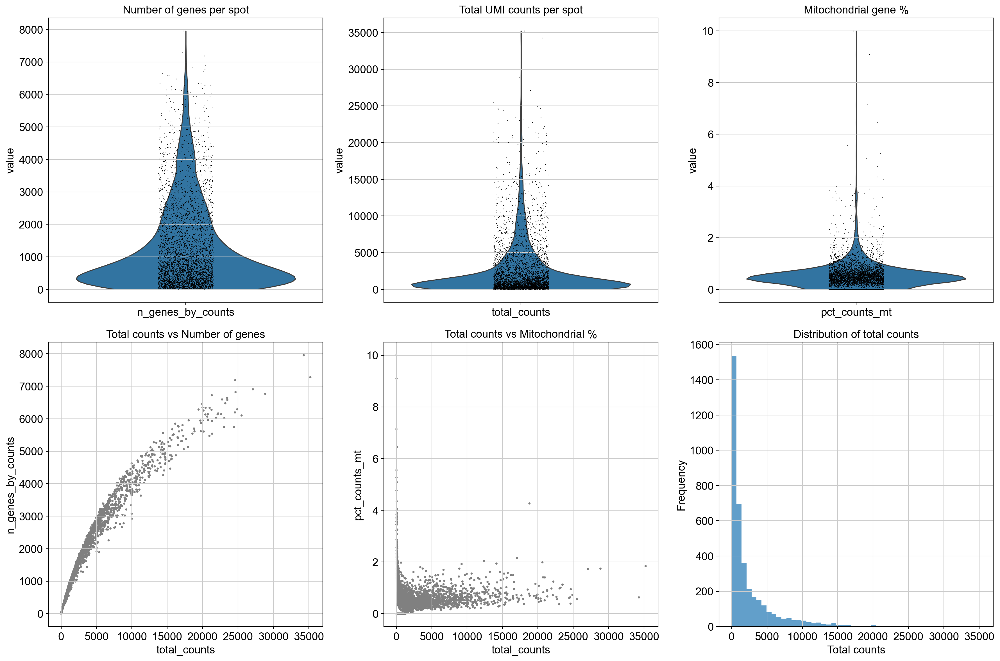

In [19]:
# Visualize QC metrics
if adata is not None:
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    
    # Violin plots for QC metrics
    sc.pl.violin(adata, ['n_genes_by_counts'], ax=axes[0,0], show=False)
    axes[0,0].set_title('Number of genes per spot')
    
    sc.pl.violin(adata, ['total_counts'], ax=axes[0,1], show=False)
    axes[0,1].set_title('Total UMI counts per spot')
    
    sc.pl.violin(adata, ['pct_counts_mt'], ax=axes[0,2], show=False)
    axes[0,2].set_title('Mitochondrial gene %')
    
    # Scatter plots
    sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts', ax=axes[1,0], show=False)
    axes[1,0].set_title('Total counts vs Number of genes')
    
    sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt', ax=axes[1,1], show=False)
    axes[1,1].set_title('Total counts vs Mitochondrial %')
    
    # Histogram of total counts
    axes[1,2].hist(adata.obs['total_counts'], bins=50, alpha=0.7)
    axes[1,2].set_xlabel('Total counts')
    axes[1,2].set_ylabel('Frequency')
    axes[1,2].set_title('Distribution of total counts')
    
    plt.tight_layout()
    plt.savefig(f'/Users/penguin/Documents/Spatial_Data/results/figures/{sample_name}_qc_metrics.png', dpi=300, bbox_inches='tight')
    plt.show()
else:
    print("No data available for visualization.")

## Spatial Visualization

Visualize the spatial distribution of quality control metrics and basic tissue structure.

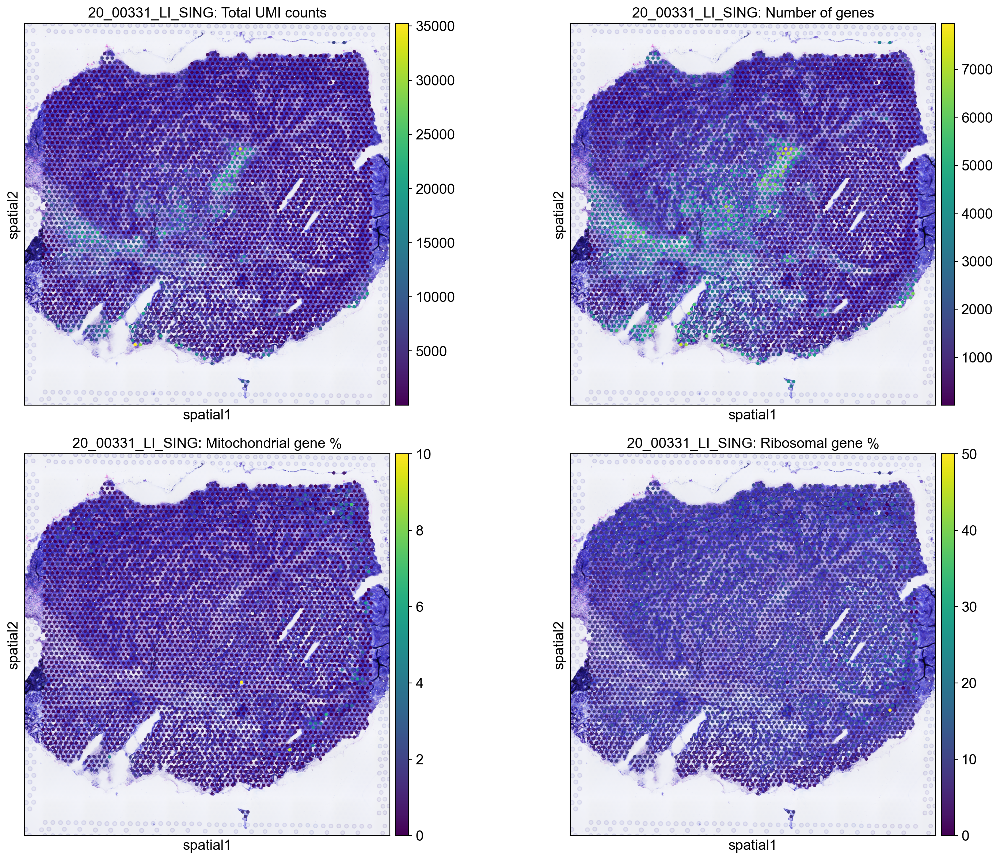


Spatial coordinates:
- Shape: (3834, 2)
- X range: 3145.0 to 25364.0
- Y range: 3425.0 to 26657.0


In [21]:
# Spatial visualization of QC metrics
if adata is not None:
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    
    # Spatial plots with different metrics
    sc.pl.spatial(adata, color="total_counts", ax=axes[0,0], show=False, 
                  title=f"{sample_name}: Total UMI counts", colorbar_loc="right")
    
    sc.pl.spatial(adata, color="n_genes_by_counts", ax=axes[0,1], show=False,
                  title=f"{sample_name}: Number of genes", colorbar_loc="right")
    
    sc.pl.spatial(adata, color="pct_counts_mt", ax=axes[1,0], show=False,
                  title=f"{sample_name}: Mitochondrial gene %", colorbar_loc="right")
    
    sc.pl.spatial(adata, color="pct_counts_ribo", ax=axes[1,1], show=False,
                  title=f"{sample_name}: Ribosomal gene %", colorbar_loc="right")
    
    plt.tight_layout()
    plt.savefig(f'/Users/penguin/Documents/Spatial_Data/results/figures/{sample_name}_spatial_qc.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    # Display spatial coordinates info
    if 'spatial' in adata.obsm:
        spatial_coords = adata.obsm['spatial']
        print(f"\nSpatial coordinates:")
        print(f"- Shape: {spatial_coords.shape}")
        print(f"- X range: {spatial_coords[:, 0].min():.1f} to {spatial_coords[:, 0].max():.1f}")
        print(f"- Y range: {spatial_coords[:, 1].min():.1f} to {spatial_coords[:, 1].max():.1f}")
else:
    print("No data available for spatial visualization.")

## Data Preprocessing and Filtering

Apply quality control filters and normalize the data for downstream analysis.

In [22]:
# Data preprocessing and filtering
if adata is not None:
    print(f"Before filtering: {adata.n_obs} spots, {adata.n_vars} genes")
    
    # Save raw data
    adata.raw = adata
    
    # Filter spots and genes based on QC metrics
    # Remove spots with too few or too many genes (potential doublets or empty spots)
    min_genes = 200
    max_genes = adata.obs['n_genes_by_counts'].quantile(0.98)
    
    # Remove spots with too high mitochondrial gene percentage
    max_mt = 20
    
    print(f"\nApplying filters:")
    print(f"- Minimum genes per spot: {min_genes}")
    print(f"- Maximum genes per spot: {max_genes:.0f}")
    print(f"- Maximum mitochondrial %: {max_mt}")
    
    # Filter spots
    sc.pp.filter_cells(adata, min_genes=min_genes)
    adata = adata[adata.obs.n_genes_by_counts < max_genes, :]
    adata = adata[adata.obs.pct_counts_mt < max_mt, :]
    
    # Filter genes (expressed in at least 3 spots)
    sc.pp.filter_genes(adata, min_cells=3)
    
    print(f"After filtering: {adata.n_obs} spots, {adata.n_vars} genes")
    print(f"Removed: {adata.raw.n_obs - adata.n_obs} spots, {adata.raw.n_vars - adata.n_vars} genes")
    
    # Normalization
    print(f"\nNormalizing data...")
    sc.pp.normalize_total(adata, target_sum=1e4)
    sc.pp.log1p(adata)
    
    print("✓ Data normalized and log-transformed")
else:
    print("No data available for preprocessing.")

Before filtering: 3834 spots, 36601 genes

Applying filters:
- Minimum genes per spot: 200
- Maximum genes per spot: 5122
- Maximum mitochondrial %: 20
After filtering: 3135 spots, 18926 genes
Removed: 0 spots, 17675 genes

Normalizing data...
✓ Data normalized and log-transformed


## Feature Selection and Dimensionality Reduction

Identify highly variable genes and perform principal component analysis.

Finding highly variable genes...
Highly variable genes: 5487


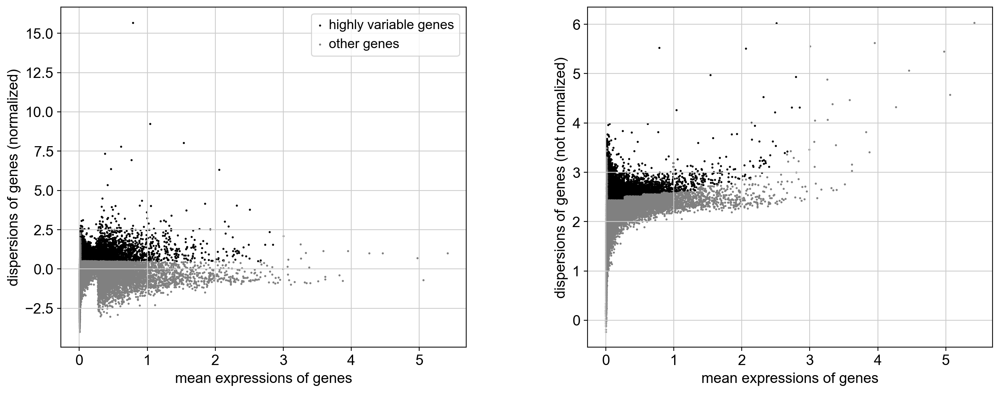

<Figure size 800x600 with 0 Axes>

Scaling data...
Performing PCA...


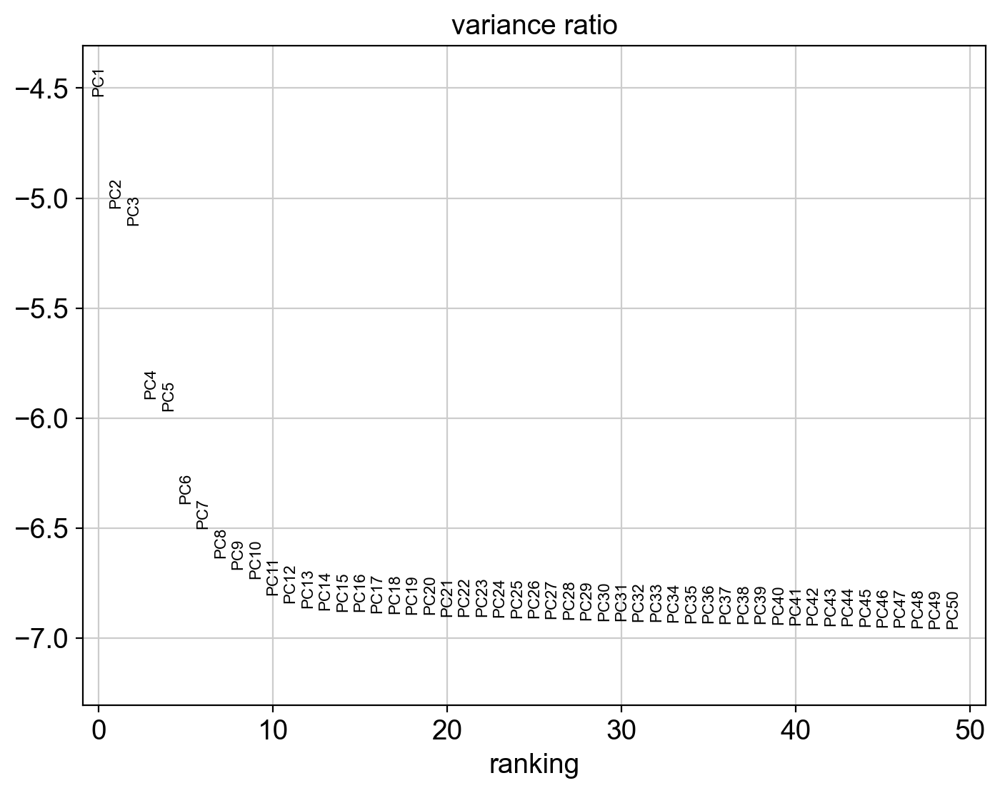

<Figure size 800x600 with 0 Axes>

✓ Feature selection and PCA completed


In [25]:
# Feature selection and dimensionality reduction
if adata is not None:
    # Find highly variable genes
    print("Finding highly variable genes...")
    sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
    
    print(f"Highly variable genes: {adata.var.highly_variable.sum()}")
    
    # Plot highly variable genes
    sc.pl.highly_variable_genes(adata)
    plt.savefig(f'/Users/penguin/Documents/Spatial_Data/results/figures/{sample_name}_highly_variable_genes.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    # Keep only highly variable genes for downstream analysis
    adata_hvg = adata[:, adata.var.highly_variable].copy()
    
    # Scale the data
    print("Scaling data...")
    sc.pp.scale(adata_hvg, max_value=10)
    
    # Principal component analysis
    print("Performing PCA...")
    sc.tl.pca(adata_hvg, svd_solver='arpack')
    
    # Plot PCA variance ratio
    sc.pl.pca_variance_ratio(adata_hvg, log=True, n_pcs=50)
    plt.savefig(f'/Users/penguin/Documents/Spatial_Data/results/figures/{sample_name}_pca_variance.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    # Copy PCA results back to original adata
    adata.obsm['X_pca'] = adata_hvg.obsm['X_pca']
    adata.uns['pca'] = adata_hvg.uns['pca']
    
    # Note: PCA was computed only on highly variable genes
    # We don't need to copy PCs back to the full dataset since PCA components
    # are only meaningful for the genes they were computed on
    # The PCA embeddings in obsm['X_pca'] are what we need for downstream analysis
    # If you need the PCA components later, they are available in adata_hvg.varm['PCs']
    
    print("✓ Feature selection and PCA completed")
else:
    print("No data available for feature selection.")

## Neighborhood Analysis and Clustering

Build neighborhood graph and perform clustering to identify spatial domains.

Computing neighborhood graph...
Computing UMAP embedding...
Performing Leiden clustering...
  Resolution 0.1: 2 clusters
  Resolution 0.3: 4 clusters
  Resolution 0.5: 4 clusters
  Resolution 0.8: 7 clusters
  Resolution 1.0: 8 clusters


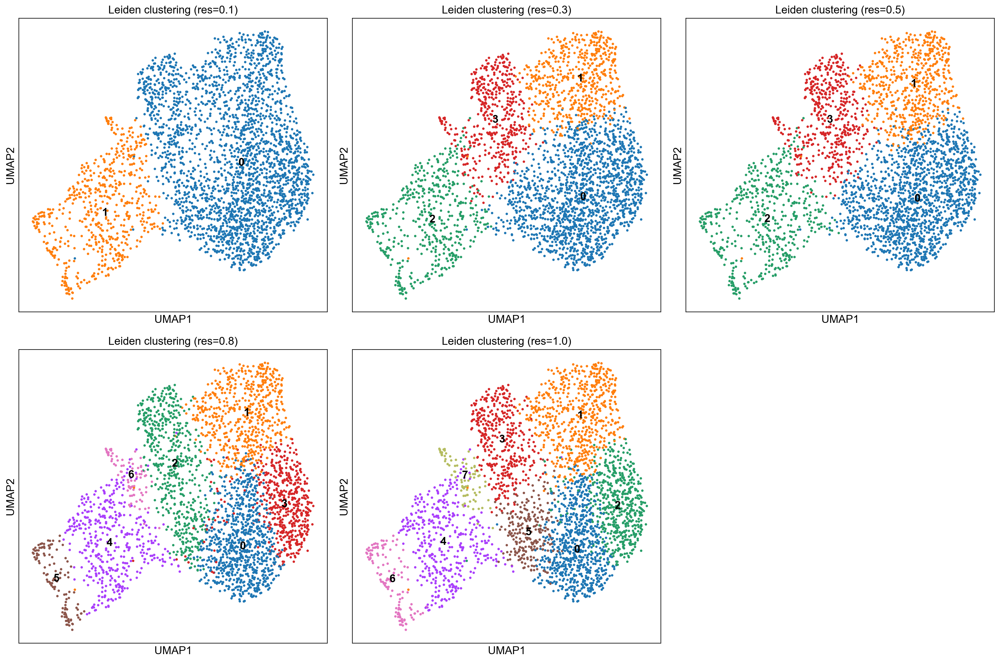

✓ Clustering completed


In [12]:
# Neighborhood analysis and clustering
if adata is not None:
    # Compute the neighborhood graph
    print("Computing neighborhood graph...")
    sc.pp.neighbors(adata, n_neighbors=15, n_pcs=40)
    
    # UMAP embedding
    print("Computing UMAP embedding...")
    sc.tl.umap(adata)
    
    # Leiden clustering with different resolutions
    print("Performing Leiden clustering...")
    resolutions = [0.1, 0.3, 0.5, 0.8, 1.0]
    
    for res in resolutions:
        sc.tl.leiden(adata, resolution=res, key_added=f'leiden_{res}')
        n_clusters = len(adata.obs[f'leiden_{res}'].cat.categories)
        print(f"  Resolution {res}: {n_clusters} clusters")
    
    # Plot UMAP with different clustering resolutions
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    axes = axes.ravel()
    
    sc.pl.umap(adata, color="leiden_0.1", ax=axes[0], show=False, legend_loc='on data')
    axes[0].set_title('Leiden clustering (res=0.1)')
    
    sc.pl.umap(adata, color="leiden_0.3", ax=axes[1], show=False, legend_loc='on data')
    axes[1].set_title('Leiden clustering (res=0.3)')
    
    sc.pl.umap(adata, color="leiden_0.5", ax=axes[2], show=False, legend_loc='on data')
    axes[2].set_title('Leiden clustering (res=0.5)')
    
    sc.pl.umap(adata, color="leiden_0.8", ax=axes[3], show=False, legend_loc='on data')
    axes[3].set_title('Leiden clustering (res=0.8)')
    
    sc.pl.umap(adata, color="leiden_1.0", ax=axes[4], show=False, legend_loc='on data')
    axes[4].set_title('Leiden clustering (res=1.0)')
    
    # Remove empty subplot
    fig.delaxes(axes[5])
    
    plt.tight_layout()
    plt.savefig(f'results/figures/{sample_name}_umap_clustering.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    print("✓ Clustering completed")
else:
    print("No data available for clustering.")

## Spatial Domain Visualization

Visualize the identified clusters in spatial context to understand tissue organization.

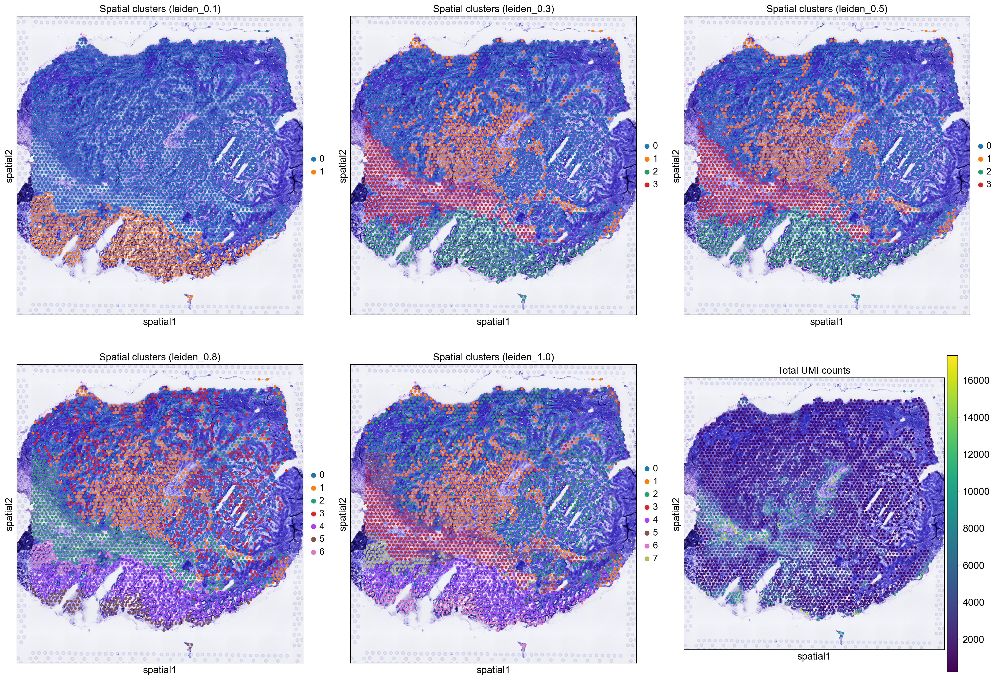


Using leiden_0.5 with 4 clusters for further analysis

Cluster statistics:
           total_counts              n_genes_by_counts          pct_counts_mt  \
                   mean          std              mean      std          mean   
leiden_0.5                                                                      
0            770.700012   460.190002            595.13   306.71          0.44   
1           4586.629883  3007.469971           2441.05  1036.98          0.46   
2           3362.489990  3200.070068           1784.55  1227.40          0.61   
3           5162.279785  3521.280029           2337.47  1086.65          0.60   

                  
             std  
leiden_0.5        
0           0.31  
1           0.19  
2           0.33  
3           0.29  
✓ Spatial domain visualization completed


In [14]:
# Spatial domain visualization
if adata is not None:
    # Plot spatial distribution of clusters
    fig, axes = plt.subplots(2, 3, figsize=(20, 14))
    axes = axes.ravel()
    
    cluster_keys = ['leiden_0.1', 'leiden_0.3', 'leiden_0.5', 'leiden_0.8', 'leiden_1.0']
    
    for i, cluster_key in enumerate(cluster_keys):
        sc.pl.spatial(adata, color=cluster_key, ax=axes[i], show=False, 
                     title=f'Spatial clusters ({cluster_key})', legend_loc='right margin')
    
    # Plot total UMI for reference
    sc.pl.spatial(adata, color="total_counts", ax=axes[5], show=False,
                 title="Total UMI counts", legend_loc='right margin')
    
    plt.tight_layout()
    plt.savefig(f'results/figures/{sample_name}_spatial_clustering.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    # Focus on optimal resolution (0.5) for detailed analysis
    optimal_resolution = 'leiden_0.5'
    n_clusters = len(adata.obs[optimal_resolution].cat.categories)
    
    print(f"\nUsing {optimal_resolution} with {n_clusters} clusters for further analysis")
    
    # Cluster statistics
    cluster_stats = adata.obs.groupby(optimal_resolution).agg({
        'total_counts': ['mean', 'std'],
        'n_genes_by_counts': ['mean', 'std'],
        'pct_counts_mt': ['mean', 'std']
    }).round(2)
    
    print("\nCluster statistics:")
    print(cluster_stats)
    
    print("✓ Spatial domain visualization completed")
else:
    print("No data available for spatial visualization.")

## Marker Gene Analysis

Identify marker genes for each spatial domain and visualize their expression patterns.

Finding marker genes for each cluster...


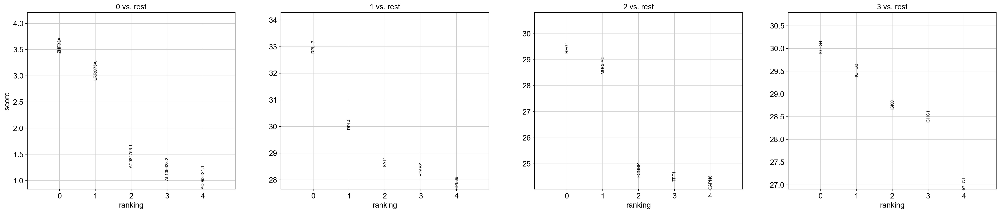

<Figure size 800x600 with 0 Axes>


Top 3 marker genes per cluster:
Cluster 0: ZNF33A, LRRC75A, AC084756.1
Cluster 1: RPL17, RPL4, SAT1
Cluster 2: REG4, MUC5AC, FCGBP
Cluster 3: IGHG4, IGHG3, IGKC


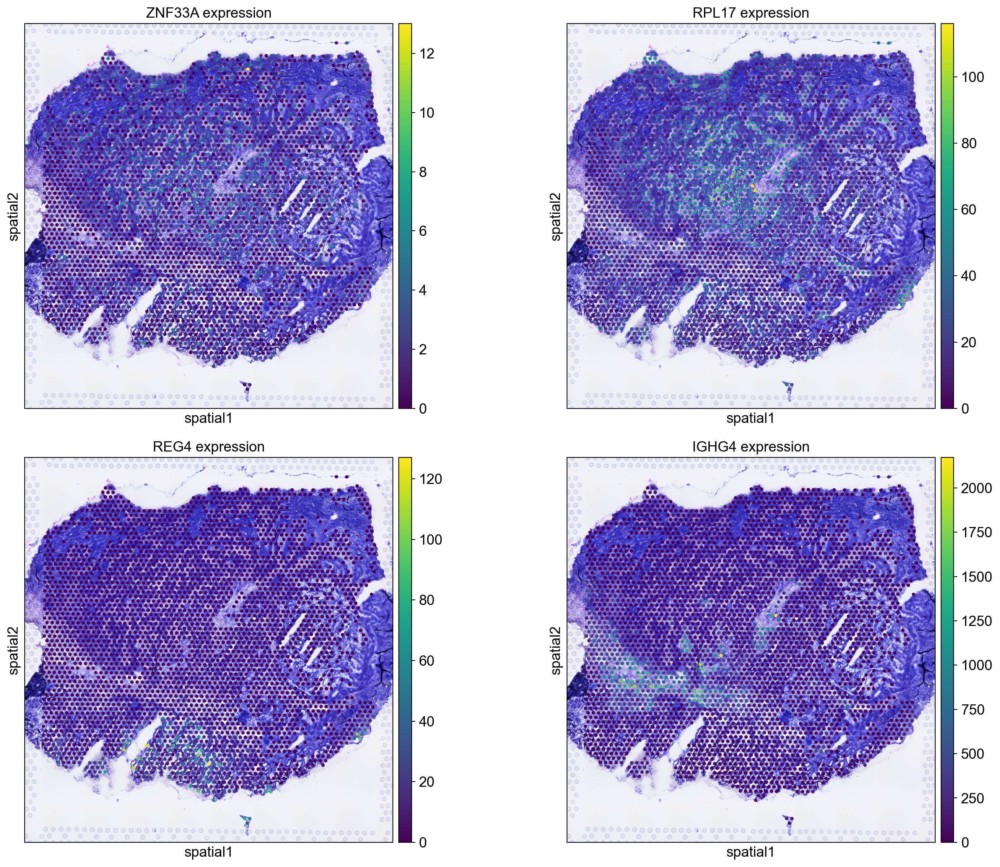

✓ Marker gene analysis completed


In [15]:
# Marker gene analysis
if adata is not None:
    # Find marker genes for each cluster
    print("Finding marker genes for each cluster...")
    sc.tl.rank_genes_groups(adata, 'leiden_0.5', method='wilcoxon')
    
    # Plot top marker genes
    sc.pl.rank_genes_groups(adata, n_genes=5, sharey=False)
    plt.savefig(f'results/figures/{sample_name}_marker_genes.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    # Get marker genes as dataframe
    marker_genes_df = sc.get.rank_genes_groups_df(adata, None)
    print(f"\nTop 3 marker genes per cluster:")
    for cluster in adata.obs['leiden_0.5'].cat.categories:
        cluster_markers = marker_genes_df[marker_genes_df['group'] == cluster].head(3)
        genes = ', '.join(cluster_markers['names'].tolist())
        print(f"Cluster {cluster}: {genes}")
    
    # Visualize expression of top marker genes spatially
    top_markers = []
    for cluster in adata.obs['leiden_0.5'].cat.categories[:4]:  # Show first 4 clusters
        cluster_markers = marker_genes_df[marker_genes_df['group'] == cluster].head(1)
        if not cluster_markers.empty:
            top_markers.append(cluster_markers['names'].iloc[0])
    
    if top_markers:
        # Spatial expression of marker genes
        fig, axes = plt.subplots(2, 2, figsize=(16, 12))
        axes = axes.ravel()
        
        for i, gene in enumerate(top_markers[:4]):
            if gene in adata.var_names:
                sc.pl.spatial(adata, color=gene, ax=axes[i], show=False,
                             title=f"{gene} expression", colorbar_loc='right')
            else:
                axes[i].text(0.5, 0.5, f'Gene {gene}\nnot found', 
                           ha='center', va='center', transform=axes[i].transAxes)
                axes[i].set_title(f"Gene: {gene}")
        
        plt.tight_layout()
        plt.savefig(f'results/figures/{sample_name}_marker_spatial.png', dpi=300, bbox_inches='tight')
        plt.show()
    
    print("✓ Marker gene analysis completed")
else:
    print("No data available for marker gene analysis.")

## Save Processed Data

Save the processed single sample data for further analysis.

In [16]:
# Save processed data
if adata is not None:
    # Save the processed AnnData object
    output_path = f"results/processed_data/{sample_name}_processed.h5ad"
    adata.write(output_path)
    print(f"✓ Processed data saved to: {output_path}")
    
    # Export marker genes to CSV
    marker_genes_df = sc.get.rank_genes_groups_df(adata, None)
    marker_output_path = f"results/processed_data/{sample_name}_marker_genes.csv"
    marker_genes_df.to_csv(marker_output_path, index=False)
    print(f"✓ Marker genes saved to: {marker_output_path}")
    
    # Summary of processed data
    print(f"\nProcessed data summary:")
    print(f"- Sample: {sample_name}")
    print(f"- Spots after filtering: {adata.n_obs}")
    print(f"- Genes after filtering: {adata.n_vars}")
    print(f"- Clusters (leiden_0.5): {len(adata.obs['leiden_0.5'].cat.categories)}")
    print(f"- PCA components: {adata.obsm['X_pca'].shape[1]}")
    print(f"- UMAP dimensions: {adata.obsm['X_umap'].shape[1]}")
    
else:
    print("No data to save.")

✓ Processed data saved to: results/processed_data/20_00331_LI_SING_processed.h5ad
✓ Marker genes saved to: results/processed_data/20_00331_LI_SING_marker_genes.csv

Processed data summary:
- Sample: 20_00331_LI_SING
- Spots after filtering: 3135
- Genes after filtering: 18926
- Clusters (leiden_0.5): 4
- PCA components: 50
- UMAP dimensions: 2


## Multi-Sample Analysis

Now let's process all samples and perform integrated analysis.

In [17]:
# Process all samples and create integrated analysis
def process_sample_quick(sample_path, sample_name):
    """Quickly process a sample with basic pipeline"""
    try:
        # Check file structure first
        files_in_sample = os.listdir(sample_path)
        h5_file = None
        positions_file = None
        scalefactors_file = None
        matrix_file = None
        barcodes_file = None
        features_file = None
        
        # Find the actual file names
        for file in files_in_sample:
            if file.endswith('_filtered_feature_bc_matrix.h5'):
                h5_file = file
            elif file.endswith('_tissue_positions_list.csv'):
                positions_file = file
            elif file.endswith('_scalefactors_json.json'):
                scalefactors_file = file
            elif file.endswith('_matrix.mtx.gz'):
                matrix_file = file
            elif file.endswith('_barcodes.tsv.gz'):
                barcodes_file = file
            elif file.endswith('_features.tsv.gz'):
                features_file = file
        
        # Method 1: Try scanpy with file copies
        if h5_file:
            try:
                import shutil
                
                # Create expected file names
                expected_h5 = os.path.join(sample_path, 'filtered_feature_bc_matrix.h5')
                expected_positions = os.path.join(sample_path, 'tissue_positions_list.csv')
                expected_scalefactors = os.path.join(sample_path, 'scalefactors_json.json')
                
                # Create spatial directory for scanpy
                spatial_dir = os.path.join(sample_path, 'spatial')
                os.makedirs(spatial_dir, exist_ok=True)
                
                # Create copies if they don't exist
                if not os.path.exists(expected_h5):
                    source_h5 = os.path.join(sample_path, h5_file)
                    if os.path.exists(source_h5):
                        shutil.copy2(source_h5, expected_h5)
                if not os.path.exists(expected_positions) and positions_file:
                    source_positions = os.path.join(sample_path, positions_file)
                    if os.path.exists(source_positions):
                        shutil.copy2(source_positions, expected_positions)
                if not os.path.exists(expected_scalefactors) and scalefactors_file:
                    source_scalefactors = os.path.join(sample_path, scalefactors_file)
                    if os.path.exists(source_scalefactors):
                        shutil.copy2(source_scalefactors, expected_scalefactors)
                
                # Copy spatial files to spatial directory
                spatial_positions = os.path.join(spatial_dir, 'tissue_positions_list.csv')
                spatial_scalefactors = os.path.join(spatial_dir, 'scalefactors_json.json')
                spatial_hires = os.path.join(spatial_dir, 'tissue_hires_image.png')
                spatial_lowres = os.path.join(spatial_dir, 'tissue_lowres_image.png')
                
                if not os.path.exists(spatial_positions) and positions_file:
                    source_positions = os.path.join(sample_path, positions_file)
                    if os.path.exists(source_positions):
                        shutil.copy2(source_positions, spatial_positions)
                
                if not os.path.exists(spatial_scalefactors) and scalefactors_file:
                    source_scalefactors = os.path.join(sample_path, scalefactors_file)
                    if os.path.exists(source_scalefactors):
                        shutil.copy2(source_scalefactors, spatial_scalefactors)
                
                # Copy image files if they exist
                hires_image = None
                lowres_image = None
                for file in files_in_sample:
                    if file.endswith('_tissue_hires_image.png'):
                        hires_image = file
                    elif file.endswith('_tissue_lowres_image.png'):
                        lowres_image = file
                
                if not os.path.exists(spatial_hires) and hires_image:
                    source_hires = os.path.join(sample_path, hires_image)
                    if os.path.exists(source_hires):
                        shutil.copy2(source_hires, spatial_hires)
                
                if not os.path.exists(spatial_lowres) and lowres_image:
                    source_lowres = os.path.join(sample_path, lowres_image)
                    if os.path.exists(source_lowres):
                        shutil.copy2(source_lowres, spatial_lowres)
                
                # Load data with scanpy
                adata = sc.read_visium(sample_path)
                adata.var_names_make_unique()  # Make variable names unique
                adata.obs['sample'] = sample_name
                
            except Exception as e1:
                # Method 2: Load H5 directly
                try:
                    h5_path = os.path.join(sample_path, h5_file)
                    adata = sc.read_10x_h5(h5_path)
                    adata.var_names_make_unique()  # Make variable names unique
                    adata.obs['sample'] = sample_name
                    
                    # Load spatial coordinates if available
                    if positions_file:
                        positions_path = os.path.join(sample_path, positions_file)
                        positions_df = pd.read_csv(positions_path, header=None, index_col=0)
                        positions_df.columns = ['in_tissue', 'array_row', 'array_col', 'pxl_row_in_fullres', 'pxl_col_in_fullres']
                        
                        # Filter to common barcodes
                        common_barcodes = adata.obs.index.intersection(positions_df.index)
                        adata = adata[common_barcodes, :]
                        positions_df = positions_df.loc[common_barcodes]
                        
                        # Add spatial coordinates
                        adata.obsm['spatial'] = positions_df[['pxl_col_in_fullres', 'pxl_row_in_fullres']].values.astype(float)
                        adata.obs['in_tissue'] = positions_df['in_tissue'].values
                        
                except Exception as e2:
                    raise e2
                    
        # Method 3: Load matrix components if H5 fails
        elif matrix_file and barcodes_file and features_file:
            try:
                import shutil
                
                # Create copies with expected names for scanpy
                expected_matrix = os.path.join(sample_path, 'matrix.mtx.gz')
                expected_barcodes = os.path.join(sample_path, 'barcodes.tsv.gz')
                expected_features = os.path.join(sample_path, 'features.tsv.gz')
                
                # Create copies
                if not os.path.exists(expected_matrix):
                    source_matrix = os.path.join(sample_path, matrix_file)
                    if os.path.exists(source_matrix):
                        shutil.copy2(source_matrix, expected_matrix)
                if not os.path.exists(expected_barcodes):
                    source_barcodes = os.path.join(sample_path, barcodes_file)
                    if os.path.exists(source_barcodes):
                        shutil.copy2(source_barcodes, expected_barcodes)
                if not os.path.exists(expected_features):
                    source_features = os.path.join(sample_path, features_file)
                    if os.path.exists(source_features):
                        shutil.copy2(source_features, expected_features)
                
                # Load using scanpy's 10x mtx reader
                adata = sc.read_10x_mtx(
                    sample_path,
                    var_names='gene_symbols',
                    cache=True
                )
                adata = adata.T  # Transpose to have observations as rows
                adata.var_names_make_unique()  # Make variable names unique
                adata.obs['sample'] = sample_name
                
                # Add spatial coordinates
                if positions_file:
                    positions_path = os.path.join(sample_path, positions_file)
                    positions_df = pd.read_csv(positions_path, header=None, index_col=0)
                    positions_df.columns = ['in_tissue', 'array_row', 'array_col', 'pxl_row_in_fullres', 'pxl_col_in_fullres']
                    
                    # Filter to common barcodes
                    common_barcodes = adata.obs.index.intersection(positions_df.index)
                    adata = adata[common_barcodes, :]
                    positions_df = positions_df.loc[common_barcodes]
                    
                    # Add spatial coordinates
                    adata.obsm['spatial'] = positions_df[['pxl_col_in_fullres', 'pxl_row_in_fullres']].values.astype(float)
                    adata.obs['in_tissue'] = positions_df['in_tissue'].values
                    
            except Exception as e3:
                raise e3
        else:
            print(f"✗ No suitable data files found in {sample_name}")
            return None
        
        # QC metrics and processing
        adata.var['mt'] = adata.var_names.str.startswith('MT-')
        sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
        
        # Basic filtering
        sc.pp.filter_cells(adata, min_genes=200)
        sc.pp.filter_genes(adata, min_cells=3)
        adata = adata[adata.obs.pct_counts_mt < 20, :]
        
        # Normalization
        adata.raw = adata
        sc.pp.normalize_total(adata, target_sum=1e4)
        sc.pp.log1p(adata)
        
        print(f"✓ Processed {sample_name}: {adata.shape}")
        return adata
        
    except Exception as e:
        print(f"✗ Failed to process {sample_name}: {e}")
        return None

# Process all samples
print("Processing all samples...")
processed_samples = []
sample_names = []

for sample_path in sample_dirs:
    sample_name = os.path.basename(sample_path)
    adata_sample = process_sample_quick(sample_path, sample_name)
    
    if adata_sample is not None:
        processed_samples.append(adata_sample)
        sample_names.append(sample_name)

print(f"\nSuccessfully processed {len(processed_samples)} samples")

    # Combine all samples
if len(processed_samples) > 1:
    print("Combining samples...")
    adata_combined = sc.concat(processed_samples, label='sample', keys=sample_names)
    adata_combined.var_names_make_unique()  # Make variable names unique
    
    print(f"Combined dataset: {adata_combined.shape}")
    print(f"Samples: {adata_combined.obs['sample'].value_counts()}")
    
else:
    print("Not enough samples for integration.")

Processing all samples...
✓ Processed 20_00331_LI_SING: (3212, 19197)
✓ Processed 21_00731_LI_SING: (4256, 21503)
✓ Processed 21_00732_LI_SING: (3042, 23074)
✓ Processed 21_00733_LI_SING: (4243, 22630)
✓ Processed 21_00734_LI_SING: (3577, 22734)
✓ Processed 21_01251_LI_SING: (2420, 19410)
✓ Processed 21_01252_LI_SING: (2456, 18574)
✓ Processed 21_01253_LI_SING: (1849, 18776)
✓ Processed 21_01254_LI_SING: (3028, 18226)
✓ Processed 21_01675_LI_SING: (3487, 21962)

Successfully processed 10 samples
Combining samples...
Combined dataset: (31570, 16061)
Samples: sample
21_00731_LI_SING    4256
21_00733_LI_SING    4243
21_00734_LI_SING    3577
21_01675_LI_SING    3487
20_00331_LI_SING    3212
21_00732_LI_SING    3042
21_01254_LI_SING    3028
21_01252_LI_SING    2456
21_01251_LI_SING    2420
21_01253_LI_SING    1849
Name: count, dtype: int64


Performing integrated analysis...
✓ Integrated analysis completed


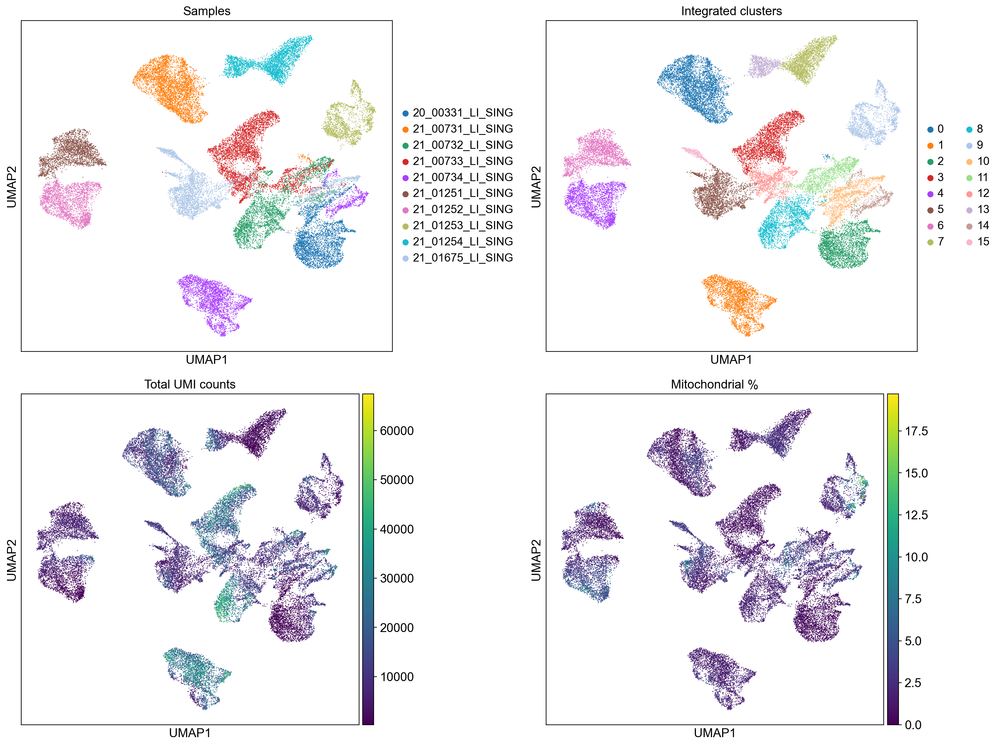

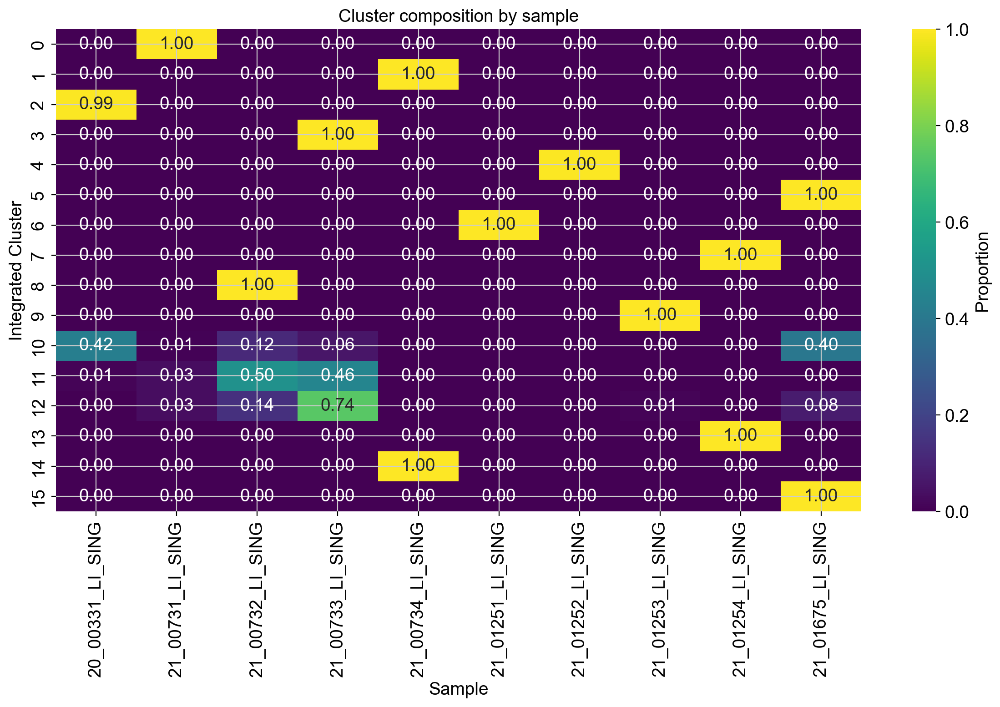

Integrated dataset: (31570, 16061)
Clusters: 16


In [18]:
# Integrated analysis of combined samples
if len(processed_samples) > 1:
    print("Performing integrated analysis...")
    
    # Find highly variable genes across all samples
    sc.pp.highly_variable_genes(adata_combined, min_mean=0.0125, max_mean=3, min_disp=0.5, 
                               batch_key='sample')
    
    # Keep only highly variable genes
    adata_hvg = adata_combined[:, adata_combined.var.highly_variable].copy()
    
    # Scale data
    sc.pp.scale(adata_hvg, max_value=10)
    
    # PCA
    sc.tl.pca(adata_hvg, svd_solver='arpack')
    
    # Neighbors and UMAP
    sc.pp.neighbors(adata_hvg, n_neighbors=15, n_pcs=40)
    sc.tl.umap(adata_hvg)
    
    # Leiden clustering
    sc.tl.leiden(adata_hvg, resolution=0.5, key_added='leiden_integrated')
    
    # Copy results back to combined data
    adata_combined.obsm['X_pca'] = adata_hvg.obsm['X_pca']
    adata_combined.obsm['X_umap'] = adata_hvg.obsm['X_umap']
    adata_combined.obs['leiden_integrated'] = adata_hvg.obs['leiden_integrated']
    adata_combined.uns.update(adata_hvg.uns)
    
    print("✓ Integrated analysis completed")
    
    # Visualize integrated results
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    
    # UMAP colored by sample
    sc.pl.umap(adata_combined, color="sample", ax=axes[0,0], show=False,
               title="Samples", legend_loc='right margin')
    
    # UMAP colored by integrated clusters
    sc.pl.umap(adata_combined, color="leiden_integrated", ax=axes[0,1], show=False,
               title="Integrated clusters", legend_loc='right margin')
    
    # Total counts
    sc.pl.umap(adata_combined, color="total_counts", ax=axes[1,0], show=False,
               title="Total UMI counts")
    
    # Mitochondrial percentage
    sc.pl.umap(adata_combined, color="pct_counts_mt", ax=axes[1,1], show=False,
               title="Mitochondrial %")
    
    plt.tight_layout()
    plt.savefig('results/figures/integrated_analysis_overview.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    # Sample composition analysis
    sample_composition = pd.crosstab(adata_combined.obs['leiden_integrated'], 
                                   adata_combined.obs['sample'], normalize='index')
    
    plt.figure(figsize=(12, 8))
    sns.heatmap(sample_composition, annot=True, fmt='.2f', cmap='viridis',
                cbar_kws={'label': 'Proportion'})
    plt.title('Cluster composition by sample')
    plt.xlabel('Sample')
    plt.ylabel('Integrated Cluster')
    plt.tight_layout()
    plt.savefig('results/figures/sample_composition_heatmap.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    print(f"Integrated dataset: {adata_combined.shape}")
    print(f"Clusters: {len(adata_combined.obs['leiden_integrated'].cat.categories)}")

else:
    print("Integrated analysis skipped - not enough samples.")

## Final Summary and Data Export

Save all processed data and generate a comprehensive summary of the analysis.

In [ ]:
# Final data export and summary
print("=== GSE251950 Spatial Transcriptomics Analysis Summary ===")
print(f"Dataset: Gastric Cancer Spatial Transcriptomics (10X Visium)")
print(f"Analysis date: {pd.Timestamp.now().strftime('%Y-%m-%d %H:%M:%S')}")

if len(processed_samples) > 0:
    # Save integrated data if available
    if len(processed_samples) > 1 and 'adata_combined' in locals():
        adata_combined.write("results/processed_data/integrated_all_samples.h5ad")
        print(f"\n✓ Integrated data saved: results/processed_data/integrated_all_samples.h5ad")
    
    # Save individual processed samples
    for i, (sample_data, sample_name) in enumerate(zip(processed_samples, sample_names)):
        sample_path = f"results/processed_data/{sample_name}_processed.h5ad"
        sample_data.write(sample_path)
        print(f"✓ Sample {i+1} saved: {sample_path}")
    
    # Generate summary statistics
    summary_stats = []
    for sample_data, sample_name in zip(processed_samples, sample_names):
        stats = {
            'Sample': sample_name,
            'Spots': sample_data.n_obs,
            'Genes': sample_data.n_vars,
            'Mean_UMI': sample_data.obs['total_counts'].mean(),
            'Mean_Genes': sample_data.obs['n_genes_by_counts'].mean(),
            'Mean_MT_pct': sample_data.obs['pct_counts_mt'].mean()
        }
        summary_stats.append(stats)
    
    summary_df = pd.DataFrame(summary_stats)
    summary_df.to_csv("results/processed_data/analysis_summary.csv", index=False)
    
    print(f"\nSample Summary:")
    print(summary_df.round(2))
    
    # Analysis completion summary
    print(f"\n=== Analysis Results ===")
    print(f"Total samples processed: {len(processed_samples)}")
    print(f"Individual sample analyses: ✓ Complete")
    
    if len(processed_samples) > 1:
        print(f"Integrated analysis: ✓ Complete")
        if 'adata_combined' in locals():
            print(f"Combined dataset: {adata_combined.n_obs} spots, {adata_combined.n_vars} genes")
            print(f"Integrated clusters: {len(adata_combined.obs['leiden_integrated'].cat.categories)}")
    
    print(f"\n=== Output Files ===")
    print(f"- Processed data: results/processed_data/")
    print(f"- Figures: results/figures/")
    print(f"- Summary: results/processed_data/analysis_summary.csv")
    
    print(f"\n✓ GSE251950 spatial transcriptomics analysis completed successfully!")

else:
    print("No samples were successfully processed.")